# **Demo for Deep Kernel Learning Driven Microscopy**



This notebook shows how deep kernel learning (DKL) works in operating microscopy using a pre-acquired piezoresponse spectrscopy (PS) hyperspectra data to simulate microscopy experiment.

The DKL code is implemented using GPax
package https://github.com/ziatdinovmax/gpax.

* This workflow notebook is prepared by [Yongtao Liu](https://scholar.google.com/citations?user=V9FMPgQAAAAJ&hl=en). Update date: Nov 2024
* The piezoresponse spectroscopy data is acquired by [Yongtao Liu](https://scholar.google.com/citations?user=V9FMPgQAAAAJ&hl=en) from a PTO sample synthesized by Hiroshi Funakubo group.
* The workflow is implemented using [DTMicroscopy](https://github.com/pycroscopy/DTMicroscope)

The workflow of DKL-driven microscopy

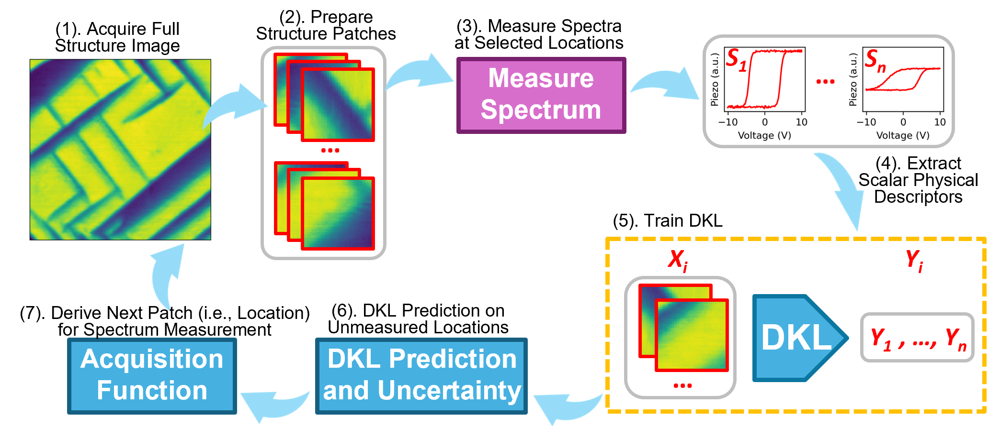

### **Application**
* DKL-driven microscopy for scientific discovery can be seen through its application in [ferroelectric polarization study](https://www.nature.com/articles/s42256-022-00460-0), [non-linear behavior investigation](https://onlinelibrary.wiley.com/doi/full/10.1002/smll.202204130), and [halide perovskites](https://pubs.acs.org/doi/full/10.1021/acs.jpclett.3c00223).

### **Further developments**
* DKL can also be combined with other ML methods such as reinforcement learning to further enhance its capability, see [example](https://www.nature.com/articles/s41524-023-00985-x)
* We also offer an example of integerating human knowledge and interest into DKL-driven autonomous experiment, see [example 1](https://arxiv.org/abs/2408.02071) and [example 2](https://arxiv.org/abs/2409.12295)

## Installation and import

In [ ]:
!pip install -q gpax
!pip install -q atomai
!pip install --upgrade gdown
!pip install pyro5
!pip install scifireaders
!pip install sidpy
!pip install pynsid
!pip install git+https://github.com/pycroscopy/DTMicroscope.git

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.4/103.4 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 373.9/373.9 kB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 351.1/351.1 kB 21.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 kB 7.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.6/162.6 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 277.8/277.8 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.4/176.4 kB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 27.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.1/79.1 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.2/84.2 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.4/102.4 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 63.7 MB/s eta 0:00:00
   ━━

In [ ]:
from warnings import filterwarnings

import numpy as np
import matplotlib.pyplot as plt
import math
import os
import Pyro5.api
from IPython.display import clear_output, display
from sklearn.model_selection import train_test_split

import gpax
from atomai.utils import get_coord_grid, extract_patches_and_spectra, extract_subimages

gpax.utils.enable_x64()
filterwarnings("ignore", module="haiku._src.data_structures")

In [ ]:
!run_server_afm

You don't have igor2 installed.     If you wish to open igor files, you will need to install it     (pip install igor2) before attempting.
You don't have gwyfile installed.     If you wish to open .gwy files, you will need to      install it (pip install gwyfile) before attempting.
Server started and running in the background. Logs are being written to server.log.


## Load a pre-acquired PS data to simulate a microscopy experiment

Download PS data:

In [ ]:
!wget -O "PTO_BEPS_1um.h5" https://www.dropbox.com/scl/fi/dwpyy2jzalcriqhza7i0c/pto_beps_1um.h5?rlkey=wg08auuxzd47fbzpx7wag5j6j&dl=1

--2024-11-19 20:48:31--  https://www.dropbox.com/scl/fi/dwpyy2jzalcriqhza7i0c/pto_beps_1um.h5?rlkey=wg08auuxzd47fbzpx7wag5j6j
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.18, 2620:100:6025:18::a27d:4512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://uc2af15eaa826cacea2a15503f46.dl.dropboxusercontent.com/cd/0/inline/CesJcfXjSkLb0lkSHRJ2EBZwkk515JA0Fd0L5QlI0O8rTs_9HGSOur4VY614Du4k2njtJZjwxWo8ojEbKgR1ZQu5XNklwRPtou-wv1QMkqZ1k09GYuA6Gqyn0kBAPBjMVFYx_s5JKVwI_OABiW5REdYx/file# [following]
--2024-11-19 20:48:33--  https://uc2af15eaa826cacea2a15503f46.dl.dropboxusercontent.com/cd/0/inline/CesJcfXjSkLb0lkSHRJ2EBZwkk515JA0Fd0L5QlI0O8rTs_9HGSOur4VY614Du4k2njtJZjwxWo8ojEbKgR1ZQu5XNklwRPtou-wv1QMkqZ1k09GYuA6Gqyn0kBAPBjMVFYx_s5JKVwI_OABiW5REdYx/file
Resolving uc2af15eaa826cacea2a15503f46.dl.dropboxusercontent.com (uc2af15eaa826cacea2a15503f46.dl.dropboxusercontent.com)... 162.125.65.15,

Load the data:

In [ ]:
import SciFiReaders as sr
nsid_reader = sr.NSIDReader('PTO_BEPS_1um.h5')
datasets = nsid_reader.read()

You don't have igor2 installed.     If you wish to open igor files, you will need to install it     (pip install igor2) before attempting.
You don't have gwyfile installed.     If you wish to open .gwy files, you will need to      install it (pip install gwyfile) before attempting.


In [ ]:
datasets

{'Channel_000': sidpy.Dataset of type IMAGE with:
  dask.array<array, shape=(50, 50), dtype=float64, chunksize=(50, 50), chunktype=numpy.ndarray>
  data contains: Piezoresponse (a.u.)
  and Dimensions: 
 x:  Length (um) of size (50,)
 y:  Length (um) of size (50,),
 'Channel_001': sidpy.Dataset of type POINT_CLOUD with:
  dask.array<array, shape=(2500, 256), dtype=float64, chunksize=(2500, 256), chunktype=numpy.ndarray>
  data contains: Piezoresponse (a.u.)
  and Dimensions: 
 point number:  Point number (generic) of size (2500,)
 Voltage:  Voltage (V) of size (256,)}

In [ ]:
%matplotlib widget
from google.colab import output
output.enable_custom_widget_manager()

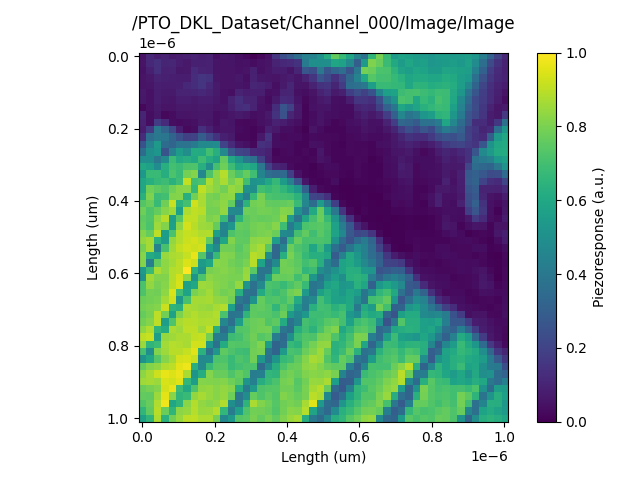

In [ ]:
#TODO: Fix the point cloud viewer scaling for the spectra.

view0 = datasets['Channel_000'].plot();

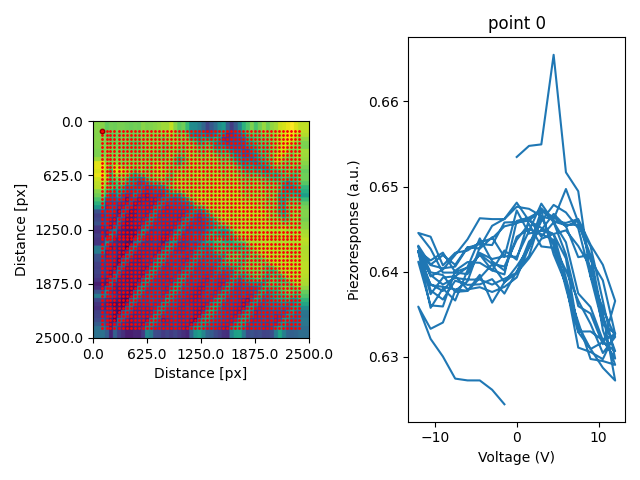

In [ ]:
view1 = datasets['Channel_001'].plot();

Plot a couple of points on top of the original image

Text(0, 0.5, 'Piezoresponse (a.u.)')

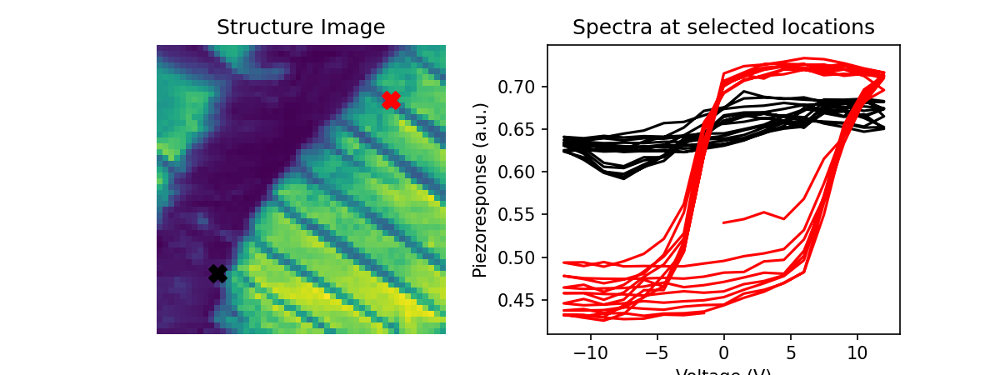

In [ ]:
image = np.array(datasets['Channel_000'])
spectra = np.array(datasets['Channel_001']).reshape(50,50,-1)
v_step = datasets['Channel_001']._axes[1].values

spec_pixel_x1 = 10; spec_pixel_y1 = 10
spec_pixel_x2 = 40; spec_pixel_y2 = 40
# Plot image and spectra at selected locations
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 3), dpi = 150)

ax1.imshow(image, origin = "lower")
ax1.scatter(spec_pixel_x1, spec_pixel_y1, marker='X', s=100, c='k')
ax1.scatter(spec_pixel_x2, spec_pixel_y2, marker='X', s=100, c='r')
ax1.set_title('Structure Image')
ax1.axis("off")

ax2.set_title("Spectra at selected locations")
ax2.plot(v_step, spectra[spec_pixel_x1, spec_pixel_y1], c = 'k')
ax2.plot(v_step, spectra[spec_pixel_x2, spec_pixel_y2], c = 'r')
ax2.set_xlabel('Voltage (V)')
ax2.set_ylabel('Piezoresponse (a.u.)')

⚡ ⚡ ⚡ ⚡ ⚡ ⚡ ⚡

***Note: This dataset includes an image showing nanoscale structures and spectra for all locations. However, in a real microscopy experiment, spectra are only available at the measured locations. Therefore, in the simulated experiment, DKL will only have access to the image and the spectra at the selected (i.e., measured) locations.***

## Deep Kernel Learning

✅ It will be easier to understand DKL-experiment by following the workflows of DKL-driven microscopy at the beginning of this notebook

Data preprocessing for DKL

In [ ]:
# Prepare image patches that show local structures
coordinates = get_coord_grid(image, step = 1, return_dict=False)

# extract image patch for each point on a grid
window_size = 16
features_all, coords, _ = extract_subimages(image, coordinates, window_size)
features = features_all[:,:,:,0]

indices_all = np.array(coords, dtype = int)

print(features.shape)

(1225, 16, 16)


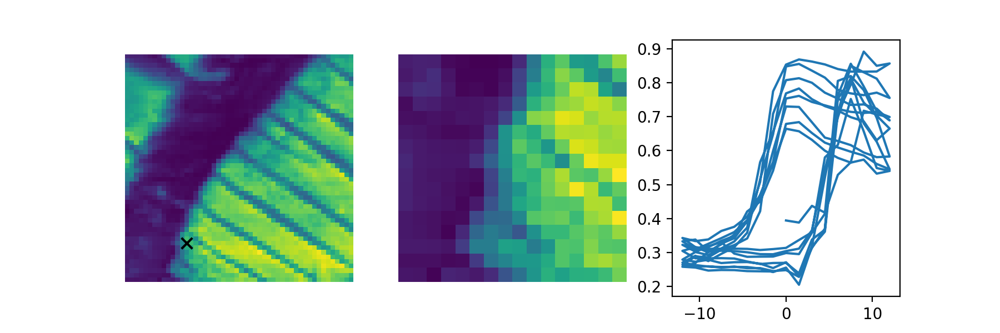

In [ ]:
#Plot an example patch and spectrum
k = 5

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(9, 3), dpi =200)
ax1.imshow(image, origin = 'lower')
ax1.scatter(indices_all[k, 1], indices_all[k, 0], marker='x', s=50, c='k')

ax1.axis("off")
ax2.imshow(features[k], origin = 'lower')
ax2.axis("off")
ax3.plot(v_step, spectra[indices_all[k, 0], indices_all[k, 1]])

Normalize data:

In [ ]:
norm_ = lambda x: (x - x.min()) / x.ptp()
features = norm_(features)

### DKL-driven microscopy experiment
Now we are going to use DKL to actively learn the relationship between local structures and their corresponding physical behavior or property, Trained DKL can make prediction for the physical property over the entire image (including unmeasured locations). We can use the prediction and uncertainty to compute acquisition function for sampling the next measurement point.

Next, we define a scalarizer function that will convert a measured spectrum into a scalar physical descriptor.

In this PS dataset, we use a scalar function that calculates the hysteresis loop area. In SNVM experiment, we need to define a different scalar function that extracts physical descriptor from SNVM spectroscopy data.

In [ ]:
nsid_reader._h5_file.close()

In [ ]:
#the first step here is to register the data to the microscope
uri = "PYRO:microscope.server@localhost:9092" #port for the AFM DT 9092
mic_server = Pyro5.api.Proxy(uri)
import sys

mic_server.initialize_microscope("AFM", data_path = r"PTO_BEPS_1um.h5")

mic_server.setup_microscope(data_source = 'Compound_Dataset_1')
mic_server.get_dataset_info()

[('channels', ['Channel_000', 'Channel_001']),
 ('signals', ['Piezoresponse', 'Piezoresponse']),
 ('units', ['a.u.', 'a.u.']),
 ('scans', [0]),
 ('spectra', []),
 ('point_clouds', [1])]

In [ ]:
# here the scalar function is to calculate the hysteresis loop area
def loop_area (raw_spec, cycle) :
  raw_spec_len = len(raw_spec)
  cycle_len = int(raw_spec_len / cycle)
  half_len = int(cycle_len / 2)
  q_len = int(cycle_len / 4)
  loop_top, loop_bottom = [], []
  loop_top.append(raw_spec[q_len : q_len + half_len])
  loop_top.append(raw_spec[q_len + 2*half_len : q_len + 3*half_len])
  loop_top.append(raw_spec[q_len + 4*half_len : 2*q_len + 4*half_len])
  loop_bottom.append(raw_spec[:q_len])
  loop_bottom.append(raw_spec[q_len + half_len: q_len + 2*half_len])
  loop_bottom.append(raw_spec[q_len + 3*half_len: q_len + 4*half_len])
  loop_top = np.concatenate(loop_top)
  loop_bottom = np.concatenate(loop_bottom)
  return np.abs(np.sum(loop_top)-np.sum(loop_bottom))

Also define a function to plot DKL sampling results (this is optional)

In [ ]:
def plot_result(indices, obj):
    plt.figure(figsize = (4, 4))
    plt.scatter(indices[:, 1], indices[:, 0], s=10, c=obj)
    next_point = indices[obj.argmax()]
    plt.scatter(next_point[1], next_point[0], s=10, marker='x', c='k')
    plt.xticks([])
    plt.yticks([])
    plt.title("Acquisition Values")
    plt.show()

define a function to convert coordinates in image to locations in microscopy measurement

In [ ]:
def convert_coordinates_to_locations(coordinates=None, image_size_x = 1e-6, image_size_y = 1e-6,
                                     num_pix_x=50, num_pix_y=50):
    """
    Converts coordinates in image to probe location in microscopy.

    Args:
        coordinates (numpy.ndarray): Array representing the original coordinates in a 2D image.
        image_size_x (float): image size in x-direction.
        image_size_y (float): image size in y-direction.
        num_pix_x (int): Number of pixels in the X-direction.
        num_pix_y (int): Number of pixels in the Y-direction.

    Returns:
        numpy.ndarray: Array representing the converted parameters of locations.

    Notes:
        - The original coordinates should be a numpy array of shape [2] with the first element representing X-coordinate
            and the second element representing Y-coordinate.
    """

    original_coordinates = np.asarray(coordinates, dtype = np.float64()) # convert to int to float first

    coor_x = original_coordinates [:,0]
    coor_y = original_coordinates [:,1]

    # convert x and y
    loc_x = coor_x * image_size_x / num_pix_x
    loc_y = coor_y * image_size_y / num_pix_y

    # write converted locations
    converted_locations = np.copy(original_coordinates)
    converted_locations[:,0] = loc_x
    converted_locations[:,1] = loc_y

    return converted_locations


Set some parameters, convert data... for DKL

In [ ]:
n, d1, d2 = features.shape
struc_imgs = features.reshape(n, d1*d2)
data_dim = struc_imgs.shape[-1]

struc_imgs.shape

(1225, 256)

In [ ]:
#print current probe position
print(f'Current location: {mic_server.x, mic_server.y}')

Current location: (3.2e-07, 2e-07)


At the beginning, we need to perform spectroscopy measurements at some locations (either random or defined by operator) to start training DKL. Here let us just perform spectroscopy at some random locations.

In [ ]:
#  initial measurement points
init_size = 3   # number of spectroscopy measurements at the beginning

# select the random locations and corresponding structure image, indices, etc.
(measured_struc, unmeasured_struc, indices_measured, indices_unmeasured) = train_test_split(
      struc_imgs, indices_all, test_size=1-init_size/len(struc_imgs), shuffle=True, random_state=10)

len(measured_struc)

3

In [ ]:
# convert the coordinates in image to locations in microscopy measurement
locations_measured = convert_coordinates_to_locations(indices_measured)
locations_measured

array([[8.0e-07, 7.0e-07],
       [4.6e-07, 2.0e-07],
       [8.0e-07, 7.4e-07]])

Now we are going to 'do' spectroscopy measurements at selected locations

Do spectroscopy at [8e-07,7e-07]
Do spectroscopy at [4.6e-07,2e-07]
Do spectroscopy at [8e-07,7.4e-07]


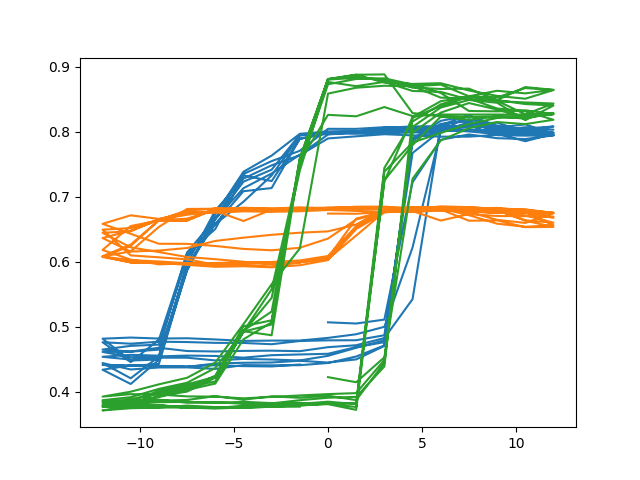

In [ ]:
#############******************************************Start**********************************###############
#############***In real experiments, this part will be replaced by spepctroscopy acquistion***###############
#  initial measurement points
init_size = 3   # number of spectroscopy measurements at the beginning
measured_spec = []
measured_spec_scalar = []
#to perform spectroscopy we can use
plt.figure()
for ind in range(init_size):
  px,py = locations_measured[ind]
  mic_server.go_to(px, py)
  print ("Do spectroscopy at [{},{}]".format(px, py))
  (spec_x, shape_spec_x, dtype_spec_x), (spec_y, shape_spec_y, dtype_spec_y) = mic_server.get_spectrum()  # Do spectrum
  _spec_x = np.array(spec_x, dtype=dtype_spec_x).reshape(shape_spec_x)
  _spec_y = np.array(spec_y, dtype=dtype_spec_y).reshape(shape_spec_y)
  measured_spec.append(_spec_y)
  measuring_spec_scalar = loop_area(_spec_y, 8)               # Convert spectrum to scalar physical descriptor
  measured_spec_scalar.append(measuring_spec_scalar)

  plt.plot(_spec_x, _spec_y)
#############***************************************************************************###############
#############***************************************************************************###############


(-0.5, 49.5, -0.5, 49.5)

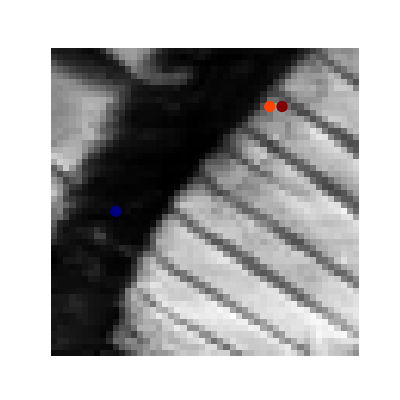

In [ ]:
# we can plot the measured locations and corresponding scalar descriptor

plt.figure(figsize=(4, 4))
plt.imshow(image, origin = "lower", cmap = "gray")
plt.scatter(indices_measured[:, 1], indices_measured[:, 0], s = 50, c=measured_spec_scalar, cmap = "jet")
plt.axis("off")

Now we are going to do DKL-driven exploration

1/50


100%|██████████| 200/200 [00:01<00:00, 118.33it/s, init loss: 20122.2406, avg. loss [191-200]: 19061.9010]



Inferred GP kernel parameters
k_length         [0.4039 0.3709]
k_scale          0.343
noise            0.3627


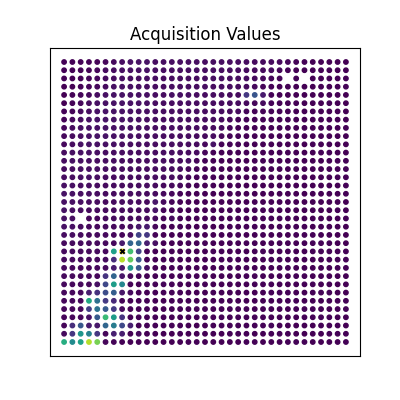

Do spectroscopy at [3.7999999999999996e-07,3e-07]
2/50


100%|██████████| 200/200 [00:02<00:00, 92.25it/s, init loss: 20123.4849, avg. loss [191-200]: 19062.6087] 



Inferred GP kernel parameters
k_length         [0.4037 0.3707]
k_scale          0.312
noise            0.34740000000000004


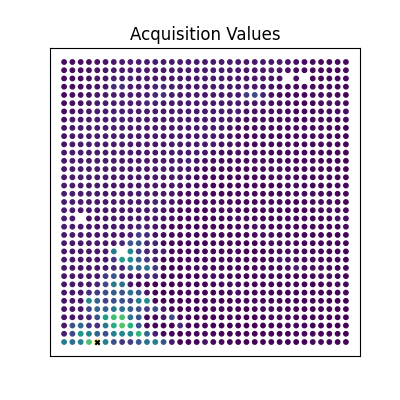

Do spectroscopy at [1.6e-07,2.4000000000000003e-07]
3/50


100%|██████████| 200/200 [00:01<00:00, 120.96it/s, init loss: 20124.7300, avg. loss [191-200]: 19063.2036]



Inferred GP kernel parameters
k_length         [0.4032 0.3699]
k_scale          0.2958
noise            0.3267


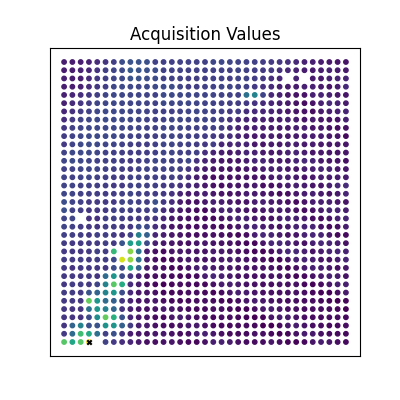

Do spectroscopy at [1.6e-07,2.1999999999999998e-07]
4/50


100%|██████████| 200/200 [00:02<00:00, 78.90it/s, init loss: 20125.9767, avg. loss [191-200]: 19063.5915] 



Inferred GP kernel parameters
k_length         [0.4029 0.37  ]
k_scale          0.29050000000000004
noise            0.2994


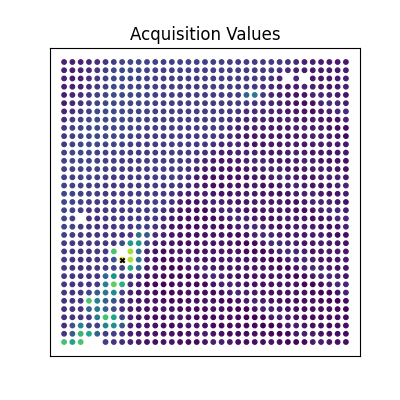

Do spectroscopy at [3.6e-07,3e-07]
5/50


100%|██████████| 200/200 [00:01<00:00, 117.53it/s, init loss: 20127.2249, avg. loss [191-200]: 19063.9469]



Inferred GP kernel parameters
k_length         [0.4022 0.3695]
k_scale          0.2864
noise            0.2798


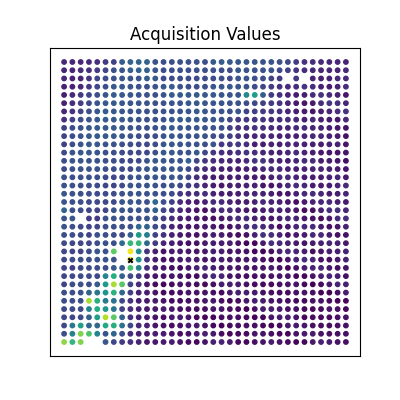

Do spectroscopy at [3.6e-07,3.2e-07]
6/50


100%|██████████| 200/200 [00:05<00:00, 33.60it/s, init loss: 20128.4603, avg. loss [191-200]: 19064.2367]



Inferred GP kernel parameters
k_length         [0.4019 0.3694]
k_scale          0.2843
noise            0.26380000000000003


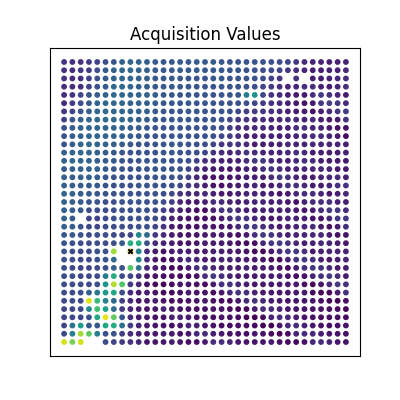

Do spectroscopy at [3.7999999999999996e-07,3.2e-07]
7/50


100%|██████████| 200/200 [00:01<00:00, 116.62it/s, init loss: 20129.6945, avg. loss [191-200]: 19063.9566]



Inferred GP kernel parameters
k_length         [0.4006 0.3077]
k_scale          0.3335
noise            0.21580000000000002


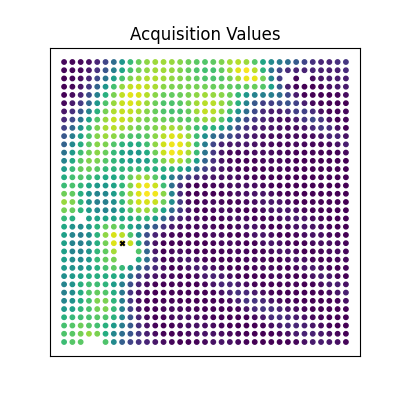

Do spectroscopy at [4e-07,3e-07]
8/50


100%|██████████| 200/200 [00:02<00:00, 75.14it/s, init loss: 20130.9408, avg. loss [191-200]: 19064.0556] 



Inferred GP kernel parameters
k_length         [0.3996 0.3084]
k_scale          0.33680000000000004
noise            0.2076


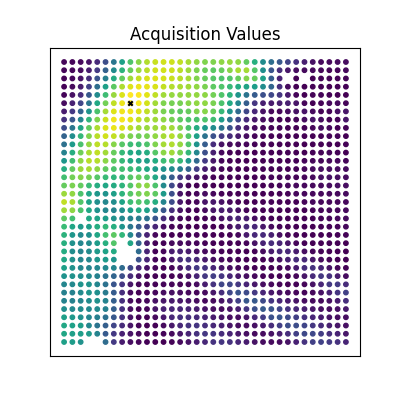

Do spectroscopy at [7.4e-07,3.2e-07]
9/50


100%|██████████| 200/200 [00:01<00:00, 115.01it/s, init loss: 20132.1878, avg. loss [191-200]: 19064.2282]



Inferred GP kernel parameters
k_length         [0.399 0.312]
k_scale          0.3355
noise            0.202


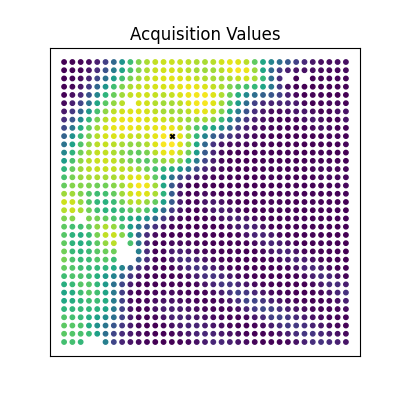

Do spectroscopy at [6.599999999999999e-07,4.2e-07]
10/50


100%|██████████| 200/200 [00:02<00:00, 78.90it/s, init loss: 20133.4371, avg. loss [191-200]: 19064.3203] 



Inferred GP kernel parameters
k_length         [0.3984 0.3154]
k_scale          0.3362
noise            0.1978


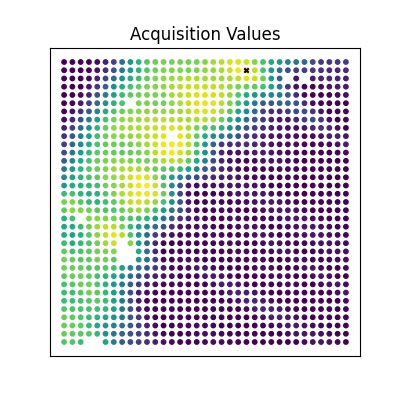

Do spectroscopy at [8.2e-07,6e-07]
11/50


100%|██████████| 200/200 [00:01<00:00, 112.63it/s, init loss: 20134.6015, avg. loss [191-200]: 19064.4651]



Inferred GP kernel parameters
k_length         [0.3983 0.3163]
k_scale          0.33630000000000004
noise            0.1943


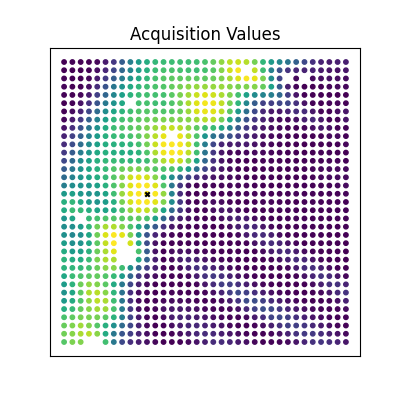

Do spectroscopy at [5.2e-07,3.6e-07]
12/50


100%|██████████| 200/200 [00:02<00:00, 75.62it/s, init loss: 20135.8213, avg. loss [191-200]: 19064.6530] 



Inferred GP kernel parameters
k_length         [0.3976 0.3171]
k_scale          0.33580000000000004
noise            0.1918


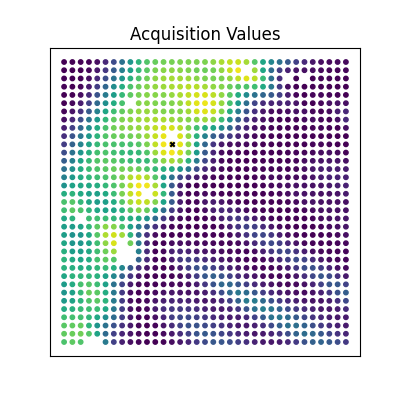

Do spectroscopy at [6.4e-07,4.2e-07]
13/50


100%|██████████| 200/200 [00:01<00:00, 109.17it/s, init loss: 20137.0090, avg. loss [191-200]: 19064.7460]



Inferred GP kernel parameters
k_length         [0.3962 0.3174]
k_scale          0.33740000000000003
noise            0.18910000000000002


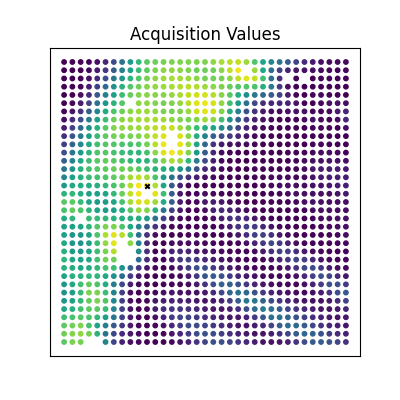

Do spectroscopy at [5.4e-07,3.6e-07]
14/50


100%|██████████| 200/200 [00:01<00:00, 108.60it/s, init loss: 20138.1945, avg. loss [191-200]: 19064.8256]



Inferred GP kernel parameters
k_length         [0.3961 0.3177]
k_scale          0.33640000000000003
noise            0.1874


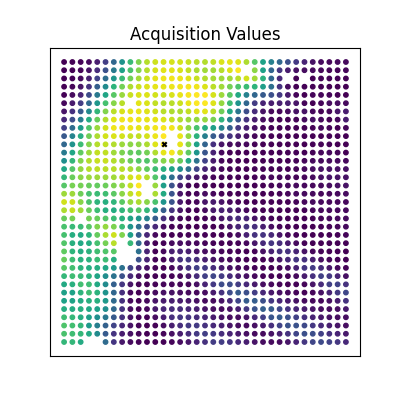

Do spectroscopy at [6.4e-07,4e-07]
15/50


100%|██████████| 200/200 [00:02<00:00, 81.35it/s, init loss: 20139.3633, avg. loss [191-200]: 19064.9607] 



Inferred GP kernel parameters
k_length         [0.3951 0.3198]
k_scale          0.33640000000000003
noise            0.1859


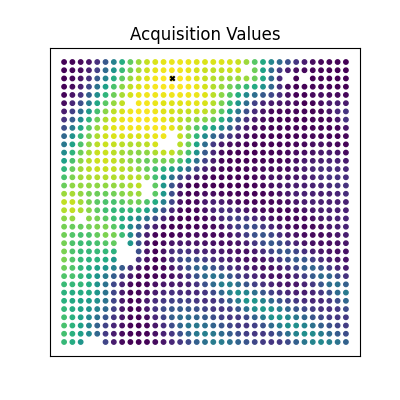

Do spectroscopy at [8e-07,4.2e-07]
16/50


100%|██████████| 200/200 [00:02<00:00, 99.57it/s, init loss: 20140.4963, avg. loss [191-200]: 19065.0480] 



Inferred GP kernel parameters
k_length         [0.3936 0.3209]
k_scale          0.33690000000000003
noise            0.1842


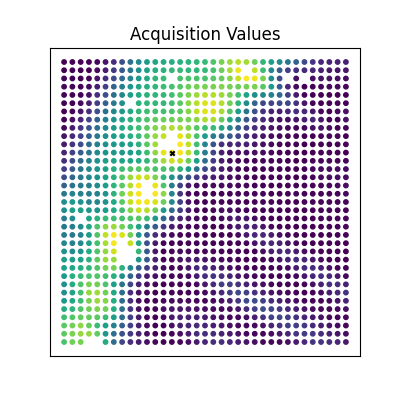

Do spectroscopy at [6.2e-07,4.2e-07]
17/50


100%|██████████| 200/200 [00:01<00:00, 101.42it/s, init loss: 20141.6100, avg. loss [191-200]: 19065.1851]



Inferred GP kernel parameters
k_length         [0.3936 0.3181]
k_scale          0.3371
noise            0.1834


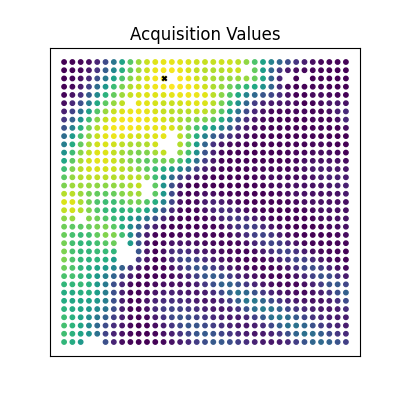

Do spectroscopy at [8e-07,4e-07]
18/50


100%|██████████| 200/200 [00:01<00:00, 102.55it/s, init loss: 20142.8501, avg. loss [191-200]: 19065.2668]



Inferred GP kernel parameters
k_length         [0.3921 0.3206]
k_scale          0.3373
noise            0.182


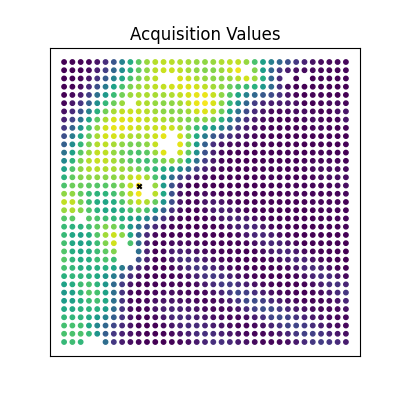

Do spectroscopy at [5.4e-07,3.4e-07]
19/50


100%|██████████| 200/200 [00:02<00:00, 95.10it/s, init loss: 20144.0310, avg. loss [191-200]: 19065.4956] 



Inferred GP kernel parameters
k_length         [0.391  0.3211]
k_scale          0.3377
noise            0.18100000000000002


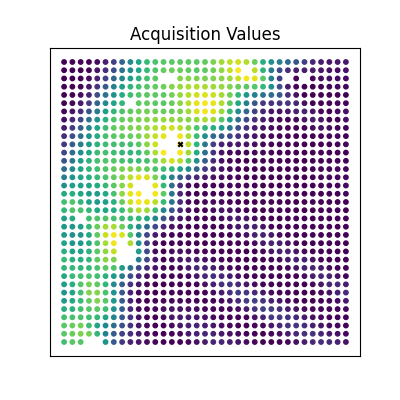

Do spectroscopy at [6.4e-07,4.3999999999999997e-07]
20/50


100%|██████████| 200/200 [00:01<00:00, 100.78it/s, init loss: 20145.1667, avg. loss [191-200]: 19065.4702]



Inferred GP kernel parameters
k_length         [0.3905 0.3203]
k_scale          0.3375
noise            0.1802


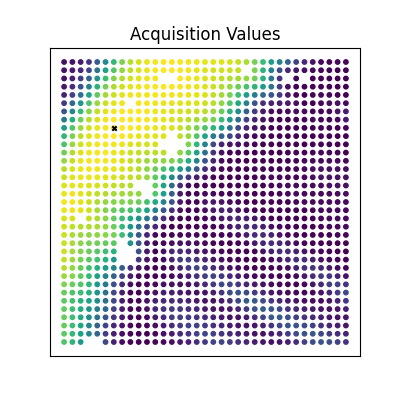

Do spectroscopy at [6.8e-07,2.8e-07]
21/50


100%|██████████| 200/200 [00:01<00:00, 100.21it/s, init loss: 20146.3734, avg. loss [191-200]: 19065.7207]



Inferred GP kernel parameters
k_length         [0.3875 0.3214]
k_scale          0.3382
noise            0.17900000000000002


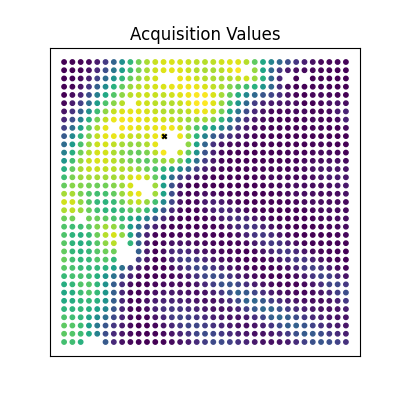

Do spectroscopy at [6.599999999999999e-07,4e-07]
22/50


100%|██████████| 200/200 [00:01<00:00, 101.04it/s, init loss: 20147.5007, avg. loss [191-200]: 19065.6663]



Inferred GP kernel parameters
k_length         [0.387  0.3245]
k_scale          0.338
noise            0.1781


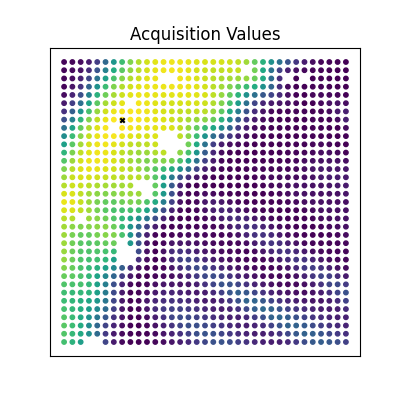

Do spectroscopy at [7e-07,3e-07]
23/50


100%|██████████| 200/200 [00:02<00:00, 99.58it/s, init loss: 20148.7175, avg. loss [191-200]: 19065.7656] 



Inferred GP kernel parameters
k_length         [0.3862 0.3253]
k_scale          0.3401
noise            0.17700000000000002


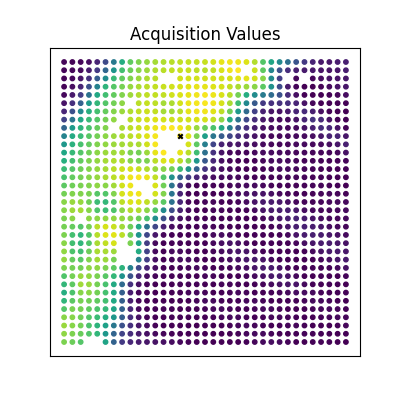

Do spectroscopy at [6.599999999999999e-07,4.3999999999999997e-07]
24/50


100%|██████████| 200/200 [00:02<00:00, 96.84it/s, init loss: 20149.8150, avg. loss [191-200]: 19065.7641] 



Inferred GP kernel parameters
k_length         [0.3846 0.3207]
k_scale          0.34040000000000004
noise            0.1767


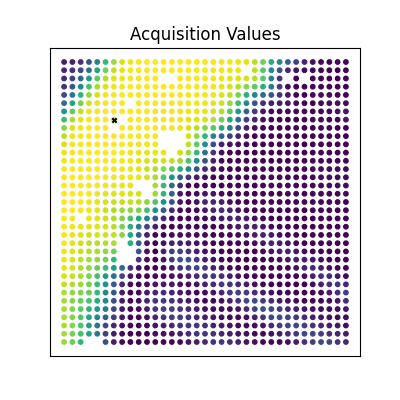

Do spectroscopy at [7e-07,2.8e-07]
25/50


100%|██████████| 200/200 [00:02<00:00, 95.50it/s, init loss: 20151.0575, avg. loss [191-200]: 19065.7298] 



Inferred GP kernel parameters
k_length         [0.386  0.3205]
k_scale          0.3416
noise            0.1758


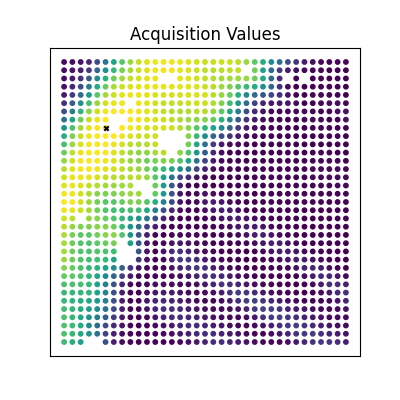

Do spectroscopy at [6.8e-07,2.6e-07]
26/50


100%|██████████| 200/200 [00:02<00:00, 98.94it/s, init loss: 20152.2934, avg. loss [191-200]: 19065.8148] 



Inferred GP kernel parameters
k_length         [0.3844 0.3241]
k_scale          0.3425
noise            0.1748


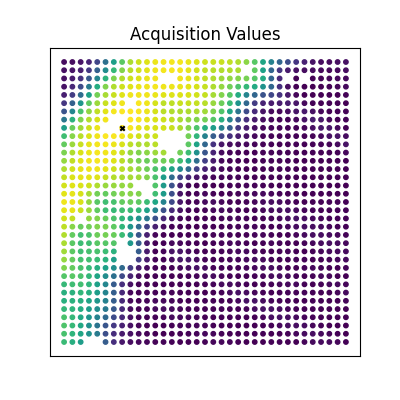

Do spectroscopy at [6.8e-07,3e-07]
27/50


100%|██████████| 200/200 [00:02<00:00, 80.30it/s, init loss: 20153.5338, avg. loss [191-200]: 19065.8922] 



Inferred GP kernel parameters
k_length         [0.3837 0.3226]
k_scale          0.3452
noise            0.17400000000000002


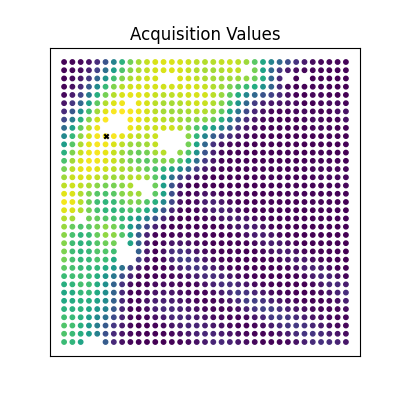

Do spectroscopy at [6.599999999999999e-07,2.6e-07]
28/50


100%|██████████| 200/200 [00:02<00:00, 95.97it/s, init loss: 20154.7485, avg. loss [191-200]: 19065.9196] 



Inferred GP kernel parameters
k_length         [0.3823 0.3197]
k_scale          0.3471
noise            0.1734


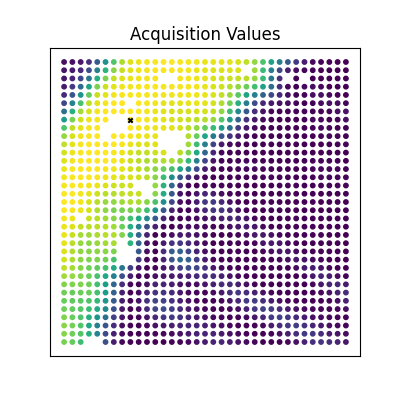

Do spectroscopy at [7e-07,3.2e-07]
29/50


100%|██████████| 200/200 [00:02<00:00, 86.89it/s, init loss: 20155.9705, avg. loss [191-200]: 19065.9034] 



Inferred GP kernel parameters
k_length         [0.3803 0.3216]
k_scale          0.3476
noise            0.17300000000000001


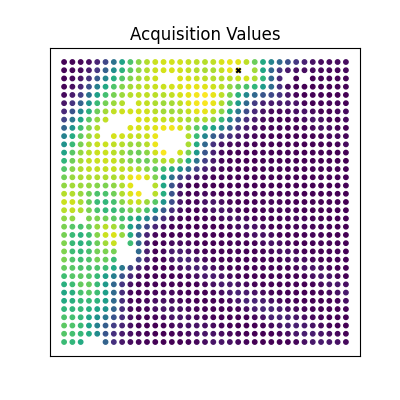

Do spectroscopy at [8.2e-07,5.8e-07]
30/50


100%|██████████| 200/200 [00:02<00:00, 97.84it/s, init loss: 20157.0840, avg. loss [191-200]: 19066.0266] 



Inferred GP kernel parameters
k_length         [0.38   0.3234]
k_scale          0.34740000000000004
noise            0.1724


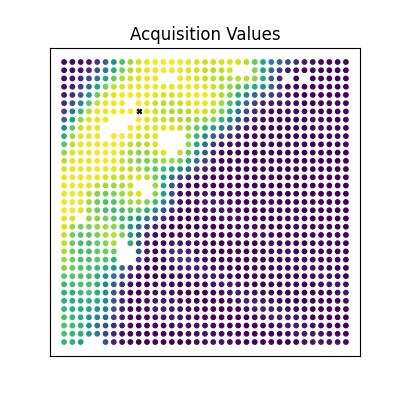

Do spectroscopy at [7.2e-07,3.4e-07]
31/50


100%|██████████| 200/200 [00:02<00:00, 92.73it/s, init loss: 20158.2407, avg. loss [191-200]: 19066.1318] 



Inferred GP kernel parameters
k_length         [0.3802 0.3254]
k_scale          0.3468
noise            0.1726


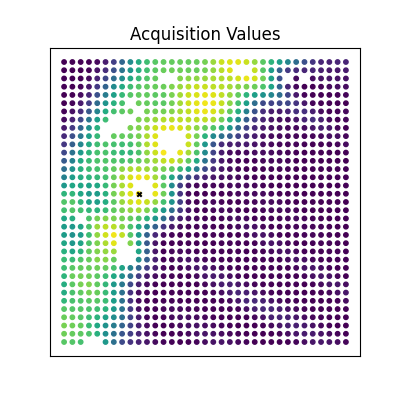

Do spectroscopy at [5.2e-07,3.4e-07]
32/50


100%|██████████| 200/200 [00:02<00:00, 91.92it/s, init loss: 20159.3708, avg. loss [191-200]: 19066.2868] 



Inferred GP kernel parameters
k_length         [0.3785 0.3295]
k_scale          0.3447
noise            0.17250000000000001


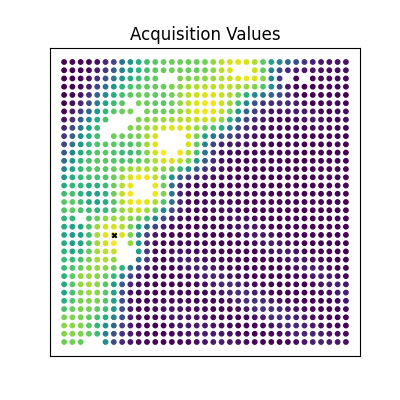

Do spectroscopy at [4.2e-07,2.8e-07]
33/50


100%|██████████| 200/200 [00:02<00:00, 81.28it/s, init loss: 20160.4776, avg. loss [191-200]: 19066.2819] 



Inferred GP kernel parameters
k_length         [0.38   0.3237]
k_scale          0.3467
noise            0.17220000000000002


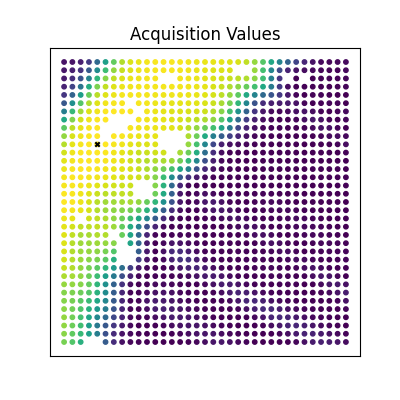

Do spectroscopy at [6.4e-07,2.4000000000000003e-07]
34/50


100%|██████████| 200/200 [00:02<00:00, 91.21it/s, init loss: 20161.6671, avg. loss [191-200]: 19066.4842] 



Inferred GP kernel parameters
k_length         [0.3796 0.3262]
k_scale          0.34700000000000003
noise            0.17200000000000001


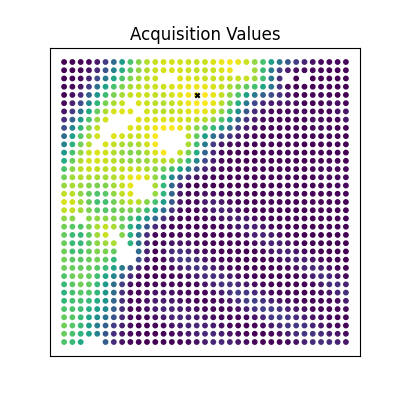

Do spectroscopy at [7.599999999999999e-07,4.800000000000001e-07]
35/50


100%|██████████| 200/200 [00:03<00:00, 56.08it/s, init loss: 20162.8274, avg. loss [191-200]: 19066.4500] 



Inferred GP kernel parameters
k_length         [0.3756 0.3244]
k_scale          0.34990000000000004
noise            0.1713


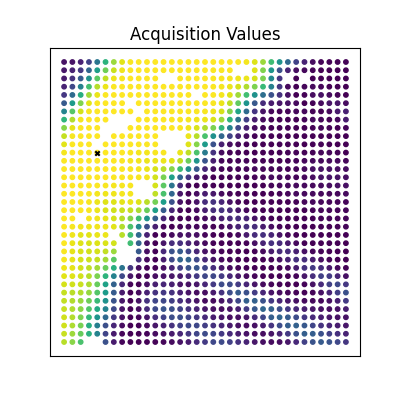

Do spectroscopy at [6.2e-07,2.4000000000000003e-07]
36/50


100%|██████████| 200/200 [00:02<00:00, 88.64it/s, init loss: 20163.9940, avg. loss [191-200]: 19066.4023] 



Inferred GP kernel parameters
k_length         [0.3782 0.3241]
k_scale          0.3501
noise            0.17120000000000002


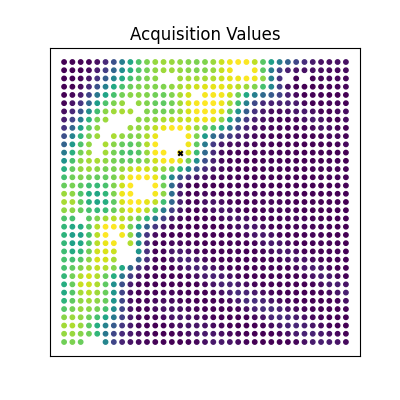

Do spectroscopy at [6.2e-07,4.3999999999999997e-07]
37/50


100%|██████████| 200/200 [00:02<00:00, 89.99it/s, init loss: 20165.0949, avg. loss [191-200]: 19067.0182] 



Inferred GP kernel parameters
k_length         [0.3743 0.3355]
k_scale          0.3472
noise            0.1711


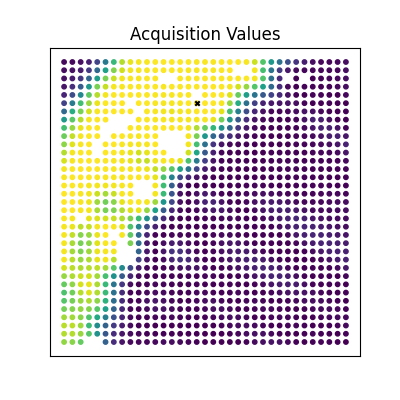

Do spectroscopy at [7.4e-07,4.800000000000001e-07]
38/50


100%|██████████| 200/200 [00:02<00:00, 92.12it/s, init loss: 20166.1821, avg. loss [191-200]: 19066.5350] 



Inferred GP kernel parameters
k_length         [0.3736 0.3291]
k_scale          0.3509
noise            0.1706


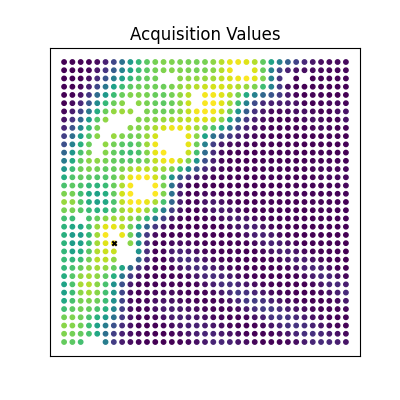

Do spectroscopy at [4e-07,2.8e-07]
39/50


100%|██████████| 200/200 [00:02<00:00, 82.62it/s, init loss: 20167.2889, avg. loss [191-200]: 19066.6521] 



Inferred GP kernel parameters
k_length         [0.3771 0.3217]
k_scale          0.3523
noise            0.1705


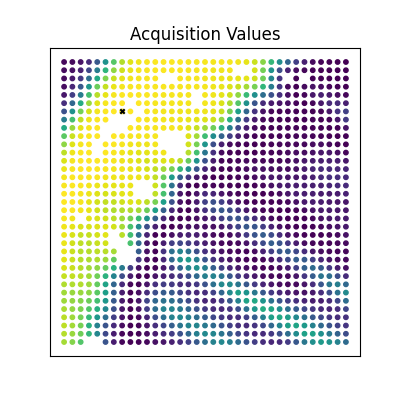

Do spectroscopy at [7.2e-07,3e-07]
40/50


100%|██████████| 200/200 [00:02<00:00, 90.36it/s, init loss: 20168.4870, avg. loss [191-200]: 19066.7264] 



Inferred GP kernel parameters
k_length         [0.3782 0.3305]
k_scale          0.3497
noise            0.1705


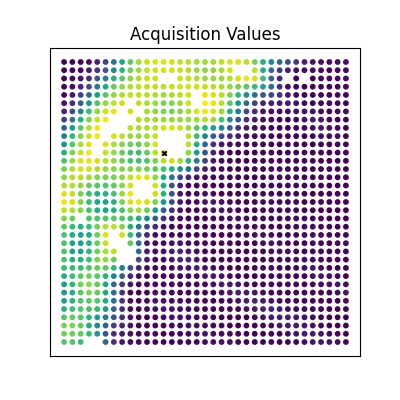

Do spectroscopy at [6.2e-07,4e-07]
41/50


100%|██████████| 200/200 [00:02<00:00, 89.55it/s, init loss: 20169.6453, avg. loss [191-200]: 19066.8201] 



Inferred GP kernel parameters
k_length         [0.3733 0.3333]
k_scale          0.3514
noise            0.17


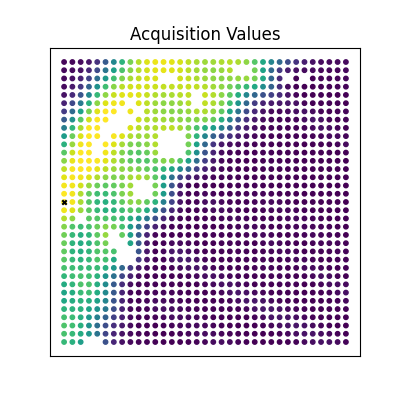

Do spectroscopy at [5e-07,1.6e-07]
42/50


100%|██████████| 200/200 [00:02<00:00, 88.12it/s, init loss: 20170.7677, avg. loss [191-200]: 19066.8435] 



Inferred GP kernel parameters
k_length         [0.3749 0.3306]
k_scale          0.3527
noise            0.16970000000000002


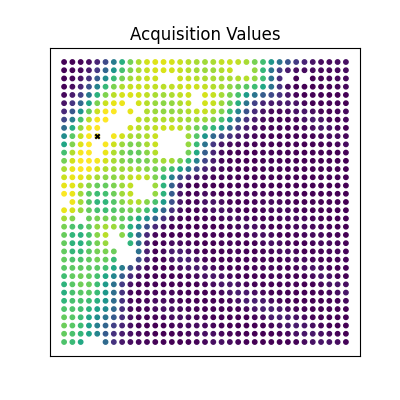

Do spectroscopy at [6.599999999999999e-07,2.4000000000000003e-07]
43/50


100%|██████████| 200/200 [00:02<00:00, 87.48it/s, init loss: 20172.0122, avg. loss [191-200]: 19066.8738] 



Inferred GP kernel parameters
k_length         [0.3741 0.3313]
k_scale          0.3546
noise            0.16920000000000002


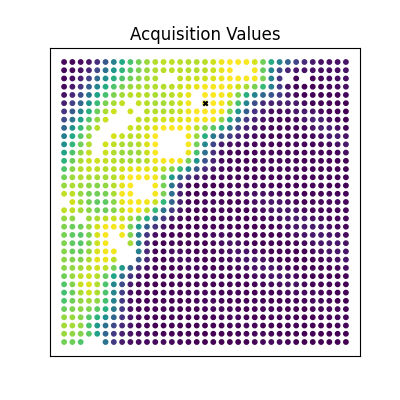

Do spectroscopy at [7.4e-07,5e-07]
44/50


100%|██████████| 200/200 [00:02<00:00, 93.21it/s, init loss: 20173.0958, avg. loss [191-200]: 19067.0601] 



Inferred GP kernel parameters
k_length         [0.3729 0.3318]
k_scale          0.35250000000000004
noise            0.1694


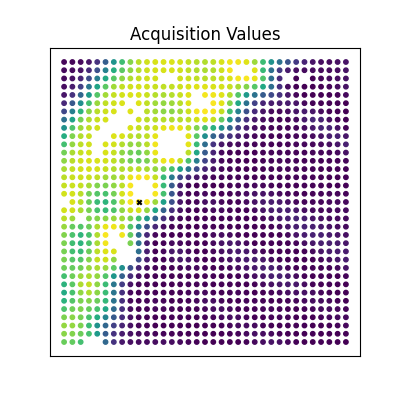

Do spectroscopy at [5e-07,3.4e-07]
45/50


100%|██████████| 200/200 [00:02<00:00, 86.38it/s, init loss: 20174.2080, avg. loss [191-200]: 19067.0776] 



Inferred GP kernel parameters
k_length         [0.3736 0.3302]
k_scale          0.3538
noise            0.1693


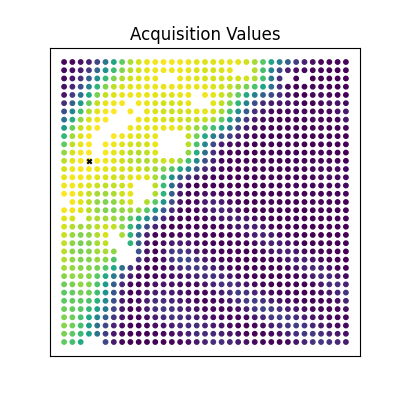

Do spectroscopy at [6e-07,2.1999999999999998e-07]
46/50


100%|██████████| 200/200 [00:02<00:00, 89.32it/s, init loss: 20175.4186, avg. loss [191-200]: 19067.0329] 



Inferred GP kernel parameters
k_length         [0.3724 0.3343]
k_scale          0.3552
noise            0.169


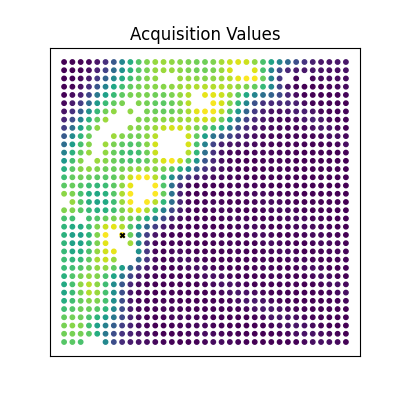

Do spectroscopy at [4.2e-07,3e-07]
47/50


100%|██████████| 200/200 [00:02<00:00, 70.30it/s, init loss: 20176.5249, avg. loss [191-200]: 19067.0940] 



Inferred GP kernel parameters
k_length         [0.3776 0.3332]
k_scale          0.3569
noise            0.16870000000000002


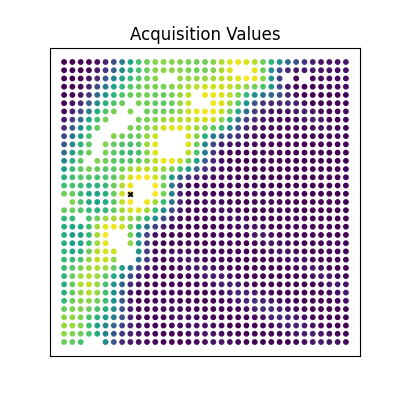

Do spectroscopy at [5.2e-07,3.2e-07]
48/50


100%|██████████| 200/200 [00:05<00:00, 39.54it/s, init loss: 20177.6057, avg. loss [191-200]: 19067.2033] 



Inferred GP kernel parameters
k_length         [0.3802 0.3335]
k_scale          0.3559
noise            0.1688


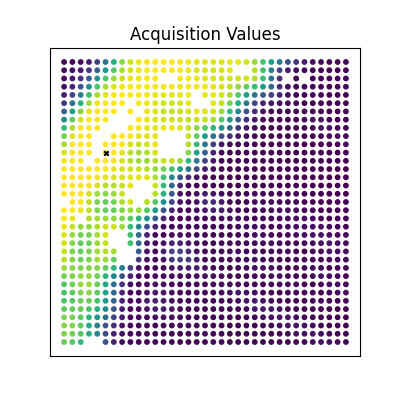

Do spectroscopy at [6.2e-07,2.6e-07]
49/50


100%|██████████| 200/200 [00:02<00:00, 81.18it/s, init loss: 20178.7712, avg. loss [191-200]: 19067.2205] 



Inferred GP kernel parameters
k_length         [0.3793 0.3349]
k_scale          0.3589
noise            0.1683


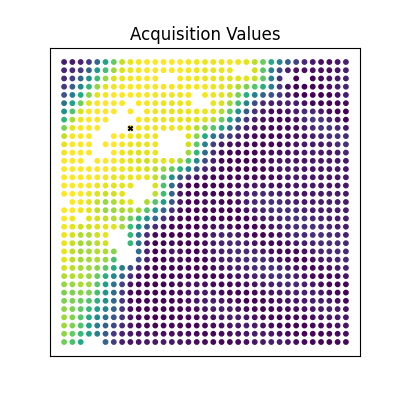

Do spectroscopy at [6.8e-07,3.2e-07]
50/50


100%|██████████| 200/200 [00:02<00:00, 87.72it/s, init loss: 20180.0014, avg. loss [191-200]: 19067.3041] 



Inferred GP kernel parameters
k_length         [0.3751 0.3342]
k_scale          0.3562
noise            0.16870000000000002


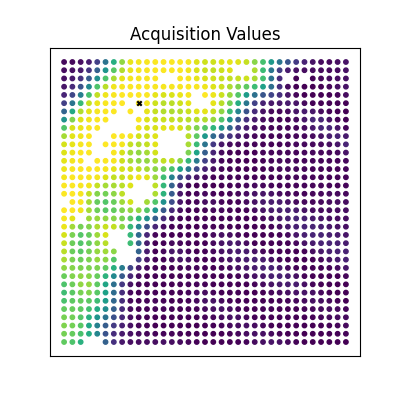

Do spectroscopy at [7.4e-07,3.4e-07]


In [ ]:
exploration_steps = 50  # iterations we want to explore

key1, key2 = gpax.utils.get_keys()
for e in range(exploration_steps):
    print("{}/{}".format(e+1, exploration_steps))

    ##########----Start-DKL training, predition, and sampling-----##########
    dkl = gpax.viDKL(data_dim, 2)
    dkl.fit(key1, measured_struc, norm_(np.asarray(measured_spec_scalar)), num_steps=200, step_size=0.01)
    obj = gpax.acquisition.EI(key2, dkl, unmeasured_struc)
    # Select next point to "measure"
    next_point_idx = obj.argmax()
    # Plot sampling result
    plot_result(indices_unmeasured, obj)
    ##########-----End-DKL training, predition, and sampling-----##########


#############************************************Start Experiment*****************************###############
#############***In real experiments, this part will be replaced by spepctroscopy acquistion***###############
    # Do "measurement"
    next_loc = convert_coordinates_to_locations(indices_unmeasured[next_point_idx][None])
    px, py = next_loc[0]
    mic_server.go_to(px, py)
    print ("Do spectroscopy at [{},{}]".format(px, py))
    (spec_x, shape_spec_x, dtype_spec_x), (spec_y, shape_spec_y, dtype_spec_y) = mic_server.get_spectrum()  # Do spectrum
    _spec_x = np.array(spec_x, dtype=dtype_spec_x).reshape(shape_spec_x)
    _spec_y = np.array(spec_y, dtype=dtype_spec_y).reshape(shape_spec_y)
    measuring_spec_scalar = loop_area(_spec_y, 8)
#############***************************************************************************###############
#############***************************************************************************###############

    # Update measured/unmeasured data
    measured_struc = np.append(measured_struc, unmeasured_struc[next_point_idx][None], 0)
    unmeasured_struc = np.delete(unmeasured_struc, next_point_idx, 0)
    measured_spec_scalar = np.append(measured_spec_scalar, measuring_spec_scalar)
    indices_measured = np.append(indices_measured, indices_unmeasured[next_point_idx][None], 0)
    indices_unmeasured = np.delete(indices_unmeasured, next_point_idx, 0)

Plot DKL sampled points and corresponding physical property

([], [])

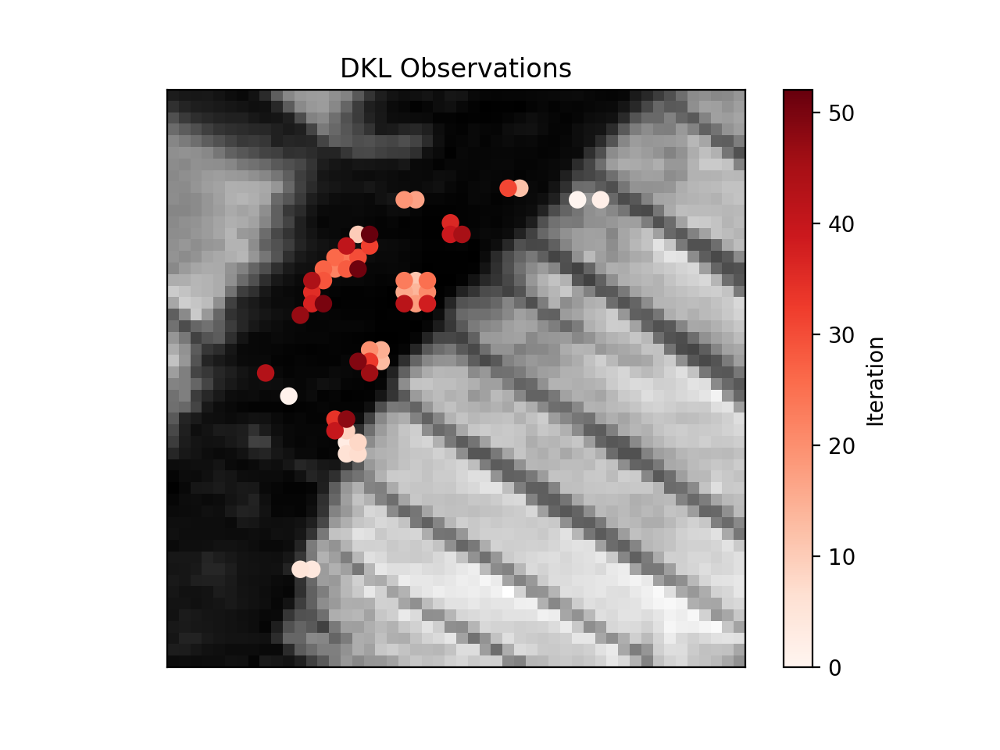

In [ ]:
plt.figure(dpi = 200)
plt.imshow(image, origin="lower", cmap='gray')
plt.scatter(indices_measured[:, 1], indices_measured[:, 0],
            c=np.arange(len(indices_measured)), s=50, cmap="Reds")
plt.colorbar(label="Iteration")
plt.title("DKL Observations")
plt.xticks([])
plt.yticks([])

Trained DKL can make prediction over the entire space

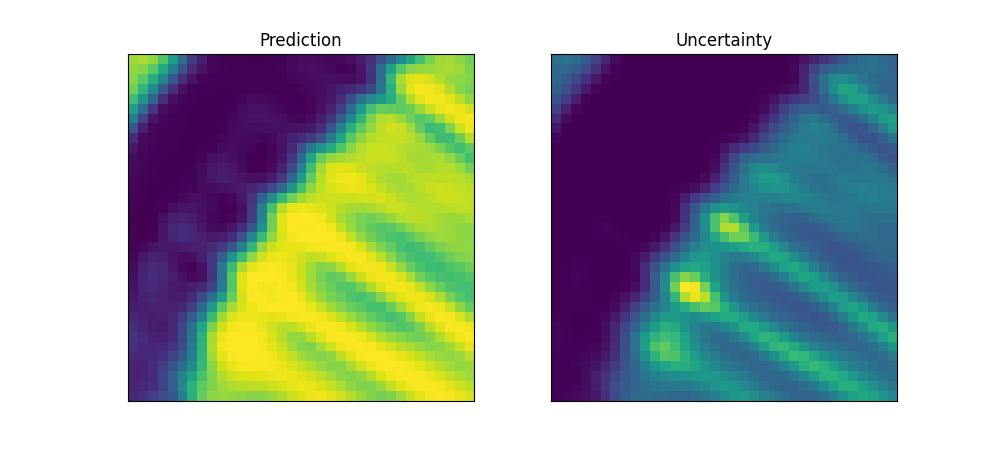

In [ ]:
mean, var = dkl.predict(key2, struc_imgs)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4.5), dpi=100)
ax1.imshow(mean.reshape((35,35)), origin = 'lower')
ax1.set_title("Prediction")
ax2.imshow(var.reshape((35,35)), origin = 'lower')
ax2.set_title("Uncertainty")
for _ax in fig.axes:
    _ax.set_aspect('equal')
    _ax.set_xticks([])
    _ax.set_yticks([])